#### 1. Load Libraries

In [1]:
# system
import os
import warnings
warnings.filterwarnings(action='ignore')

In [2]:
# data handling
import pystac_client
import odc.stac
from pystac.extensions.item_assets import ItemAssetsExtension

import geopandas as gpd
import rasterio as rio
import numpy as np
import pandas as pd
from shapely.geometry import Polygon
import xarray as xr
import rioxarray

In [3]:
# visualisation
import matplotlib.pyplot as plt
import matplotlib.colors as mplc
import holoviews as hv
import hvplot.pandas  
from holoviews import opts, dim

In [4]:
# data analysis
from sklearn import metrics  # for confusion matrix
from rasterstats import zonal_stats

#### 2. Create Separate Folder to Save Notebooks

In [5]:
notebook_folder = './notebook'
if not os.path.exists(notebook_folder):
    os.makedirs(notebook_folder)

#### 3. Load the Data from Planetary Computer API

This notebook uses annual land cover data from Impact Observatory, 10m spatial resolution and global extent for 2017-2021. These data are hosted online by Microsoft’s Planetary Computer.

Below we will use the pystac-client package to access STAC information from the Planetary Computer API, then read it using the odc-stac package. In doing so we will:
- fetch data for a study area in Mato Grosso, Brazil
- resample the original 10m spatial resolution to 300m (to decrease execution times in this example notebook)

In [6]:
# Step 1: Define study area

# specify center point of the study area
x, y = (-56.1, -12.2)  # area in MT

# define a square bounding box for the study area
km2deg = 1.0 / 111 # 1 deg corresponds to approximately 111 km at the equator
xd = 200 * km2deg
yd = 325 * km2deg
study_bbox_coords = [[x - xd, y - yd], [x - xd, y + yd], [x + xd, y + yd], [x + xd, y - yd]]

#view bounding box
study_bbox_coords

[[-57.9018018018018, -15.127927927927928],
 [-57.9018018018018, -9.27207207207207],
 [-54.2981981981982, -9.27207207207207],
 [-54.2981981981982, -15.127927927927928]]

In [7]:
# Step 2: Visualize the location using hvplot

#create a GeoPandas GeoDataFrame 
study_poly = Polygon(study_bbox_coords)

crs = {'init': 'epsg:4326'}
sa_gpd = gpd.GeoDataFrame(index=[0], crs=crs, geometry=[study_poly])  

#interactive plot using hvplot.pandas
sa_gpd_interactive = sa_gpd.hvplot(
    geo=True,crs=sa_gpd.crs.to_epsg(),alpha=0.5, xlim=(-75, -35), ylim=(-30, 10),  tiles='CartoLight')
sa_gpd_interactive

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]

In [8]:
# Step 3: Query Microsoft Planetary Computer data using psytac-client

from pystac_client import Client
from planetary_computer import sign
import odc.stac

# Use MPC's STAC API
catalog = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

# Define study area
x, y = (-56.1, -12.2)
km2deg = 1.0 / 111
xd = 200 * km2deg
yd = 325 * km2deg
bbox = [x - xd, y - yd, x + xd, y + yd]

# Search
query = catalog.search(
    collections=["io-lulc-9-class"],
    bbox=bbox,
    datetime="2017-01-01/2022-12-31",
    limit=100
)

items = list(query.get_items())
print(f"Found {len(items)} items")

# Sign STAC items with temporary tokens
signed_items = [sign(item) for item in items]

# Load data
lcxr = odc.stac.load(
    signed_items,
    bands=["data"],
    chunks={},
    fail_on_error=False,
    crs="EPSG:4326",
    resolution=0.0027
)

lcxr

Found 6 items


<xarray.Dataset> Size: 164MB
Dimensions:      (latitude: 2976, longitude: 2290, time: 6)
Coordinates:
  * latitude     (latitude) float64 24kB -7.988 -7.991 -7.993 ... -16.02 -16.02
  * longitude    (longitude) float64 18kB -60.09 -60.09 -60.08 ... -53.91 -53.91
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 48B 2017-01-01 2018-01-01 ... 2022-01-01
Data variables:
    data         (time, latitude, longitude) float32 164MB dask.array<chunksize=(1, 2976, 2290), meta=np.ndarray>

In [9]:
# For the available datasets we can access and view the associated metadata

stac_json = query.get_all_items_as_dict()     # Convert STAC items into a GeoJSON FeatureCollection
gdf = gpd.GeoDataFrame.from_features(stac_json)  # convert GeoJSON to GeoPandas to view nicely
gdf.head()

,geometry,datetime,proj:bbox,proj:epsg,io:tile_id,proj:shape,end_datetime,proj:transform,start_datetime,io:supercell_id
0,"POLYGON ((-54 -8.00195, -54 -16, -60 -16, -60 ...",None,"[169256.89710350562, 8228747.785209756, 830736...",32721,21L,"[88695, 66148]",2023-01-01T00:00:00Z,"[10.0, 0.0, 169256.89710350562, 0.0, -10.0, 91...",2022-01-01T00:00:00Z,21L
1,"POLYGON ((-54 -8.00195, -54 -16, -60 -16, -60 ...",None,"[169256.89710350562, 8228747.785209756, 830736...",32721,21L,"[88695, 66148]",2022-01-01T00:00:00Z,"[10.0, 0.0, 169256.89710350562, 0.0, -10.0, 91...",2021-01-01T00:00:00Z,21L
2,"POLYGON ((-54 -8.00195, -54 -16, -60 -16, -60 ...",None,"[169256.89710350562, 8228747.785209756, 830736...",32721,21L,"[88695, 66148]",2021-01-01T00:00:00Z,"[10.0, 0.0, 169256.89710350562, 0.0, -10.0, 91...",2020-01-01T00:00:00Z,21L
3,"POLYGON ((-54 -8.00195, -54 -16, -60 -16, -60 ...",None,"[169256.89710350562, 8228747.785209756, 830736...",32721,21L,"[88695, 66148]",2020-01-01T00:00:00Z,"[10.0, 0.0, 169256.89710350562, 0.0, -10.0, 91...",2019-01-01T00:00:00Z,21L
4,"POLYGON ((-54 -8.00195, -54 -16, -60 -16, -60 ...",None,"[169256.89710350562, 8228747.785209756, 830736...",32721,21L,"[88695, 66148]",2019-01-01T00:00:00Z,"[10.0, 0.0, 169256.89710350562, 0.0, -10.0, 91...",2018-01-01T00:00:00Z,21L


The global LULC datasets are for ‘tiles’ covering regions of the earth’s surface. Each line in the DataFrame above is for one year for tile 21L.

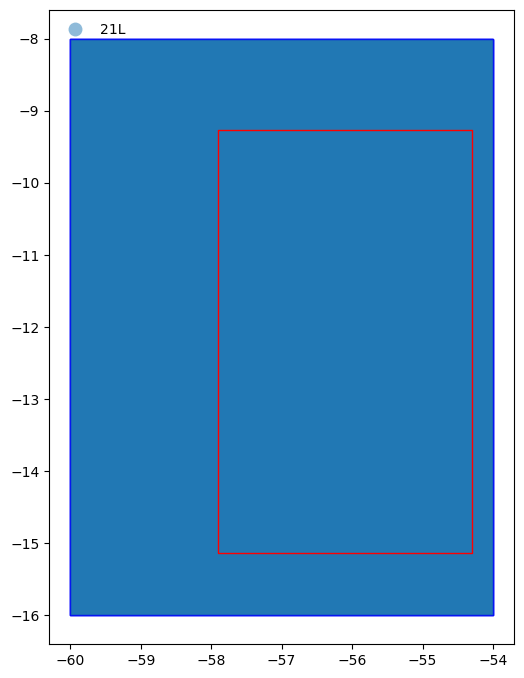

In [10]:
# Prove that study area does not cover multiple land cover tiles

%matplotlib inline
fig, axes = plt.subplots(figsize=(6, 12))

#tiles are 
gdf.plot(
    "io:tile_id",
    ax=axes,
    edgecolor="blue",
    categorical=True,
    aspect="equal",
    alpha=0.5,
    legend=True,
    legend_kwds={"loc": "upper left", "frameon": False, "ncol": 1},
)

#add polygon to show our study area
sa_gpd.plot(edgecolor="red", facecolor="none", ax=axes)

plt.show()

From the figure above we can see the whole study area (represented by the red rectangle) is within in the tiles (represented by the blue rectangles) returned by the pystac query.

Now we are happy we know what datasets we wish to fetch, we can use odc-stac to fetch and load the data into memory, specifying the projection and spatial resolution we want as well as how we want data grouped in layers:

In [11]:
# projection
SMepsg = 3857  #https://epsg.io/3857 Geographic crs, units are m
SMepsg_str = "epsg:{0}".format(SMepsg)

# spatial resolution (in units of projection)
datares = 300

# https://odc-stac.readthedocs.io/en/latest/_api/odc.stac.load.html
lcxr = odc.stac.load(
    signed_items,             #load the items from our query above
    groupby="start_datetime",  #create spatial layers that have the same timestamp     
    chunks={},         #use Dask to speed loading
    dtype='int',
    #next lines load study area at resolution specified by datares variable
    #without these entire image is returned at original resolution
    crs=SMepsg_str,    #specify the desired crs 
    resolution=datares,    #specify the desired spatial resolution (units as per crs)
    bbox=study_poly.bounds,    #specify bounding box in Lon/Lat (ignores crs units, use x,y to use crs units)
    resampling="mode"  #ensure sensible type for categorical data (options seem to be as for datacube.Datacube.load)
)

lcxr

<xarray.Dataset> Size: 143MB
Dimensions:      (y: 2225, x: 1338, time: 6)
Coordinates:
  * y            (y) float64 18kB -1.037e+06 -1.037e+06 ... -1.704e+06
  * x            (x) float64 11kB -6.446e+06 -6.445e+06 ... -6.045e+06
    spatial_ref  int32 4B 3857
  * time         (time) datetime64[ns] 48B 2017-01-01 2018-01-01 ... 2022-01-01
Data variables:
    data         (time, y, x) int64 143MB dask.array<chunksize=(1, 2225, 1338), meta=np.ndarray>

#### 4. Load Data from Local (Optional)

In the previous section we fetched data from an online repository and loaded it into memory. In the sections below we will continue to work with that (and you can skip to the next section now, if you don’t want to see how to save and/or read data from a local drive).

The recommended way to store xarray data structures is netCDF, a binary file format for self-described datasets that originated in the geosciences.

For example, to save the xarray Dataset we created above on disk as netCDF, we would use something like:

In [12]:
# lcxr_loaded = lcxr.compute()
# lcxr_loaded.to_netcdf(os.path.join(notebook_folder, "MT-study-area.nc"))

Then to load the local netCDF file into a xarray Dataset we would use:

In [13]:
# lcxr_disk = xr.open_dataset(os.path.join(notebook_folder,"MT-study-area.nc"), decode_coords="all")

#### 5. Visualization

Our dataset contains a 2D raster layer of land cover types for individual snapshots in time. Each map is a composite of land use/cover predictions for 9 classes throughout the year in order to generate a representative snapshot of each year.

We can visualise these spatio-temporal data in a variety of different ways, both static and interactive. But before exploring these, we will create a matplotlib colormap to display the 9 land cover classes with intuitive colors.

{'No Data': 0, 'Water': 1, 'Trees': 2, 'Flooded vegetation': 4, 'Crops': 5, 'Built area': 7, 'Bare ground': 8, 'Snow/ice': 9, 'Clouds': 10, 'Rangeland': 11}


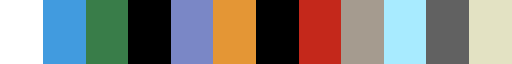

In [14]:
%matplotlib inline
#class names and IDs are held in an 'asset' of the collection
collection = catalog.get_collection("io-lulc-9-class")
ia = ItemAssetsExtension.ext(collection)
iaa = ia.item_assets["data"]

#get the names of the land cover classes with their ID in the raster (as a dictionary, name:ID)
class_names = {iaa["summary"]: iaa["values"][0] for iaa in iaa.properties["file:values"]}

#flip the keys:values in the dictionary (to create ID:name)
values_to_classes = {v: k for k, v in class_names.items()}

max_class = max(values_to_classes.keys())

#construct a matplotlib colormap
with rio.open(signed_items[0].assets["data"].href) as src:
    colormap_def = src.colormap(1)  # get metadata colormap for band 1
    colormap = [
        np.array(colormap_def[i]) / 255 for i in range(max_class+1)
    ]  # transform to matplotlib color format
lc_cmap = mplc.ListedColormap(colormap)
print(class_names)
lc_cmap

In [15]:
# Check available times
print(lcxr.time.values)

['2017-01-01T00:00:00.000000000' '2018-01-01T00:00:00.000000000'
 '2019-01-01T00:00:00.000000000' '2020-01-01T00:00:00.000000000'
 '2021-01-01T00:00:00.000000000' '2022-01-01T00:00:00.000000000']


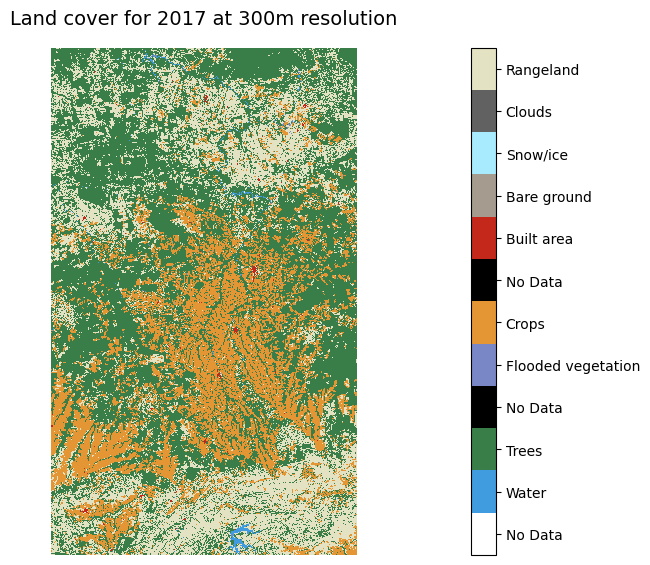

In [16]:
# Select 2017

%matplotlib inline

# plotting helpers
vmin = 0
vmax = lc_cmap.N
ts = "2017-01-01"  # corrected timestamp

# extract and plot
p = lcxr.sel(time=ts).to_array("band").plot.imshow(
    col="band",
    cmap=lc_cmap,
    vmin=vmin, vmax=vmax,
    size=6
)

# update colorbar ticks and labels
ticks = np.linspace(start=vmin + 0.5, stop=vmax - 0.5, num=vmax)
labels = [values_to_classes.get(i, "No Data") for i in range(vmax)]
p.cbar.set_ticks(ticks)
p.cbar.set_ticklabels(labels)

plt.axis("scaled")
plt.axis("off")
plt.title(f"Land cover for {ts[:4]} at {datares}m resolution", size=14)
plt.show()

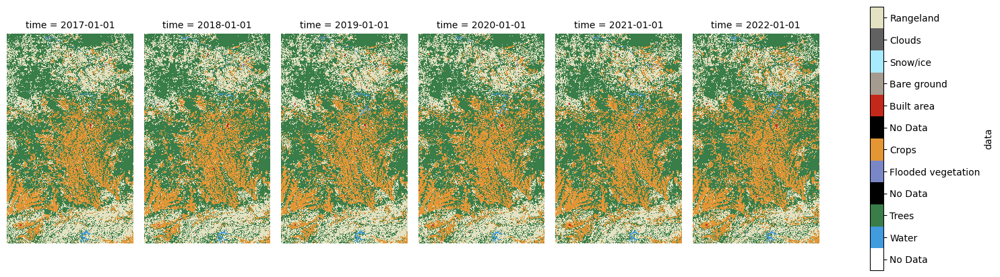

In [17]:
# Similarly, make a static plot showing maps for each point in time to visually examine change.

%matplotlib inline
p = lcxr.data.plot(
    col="time",
    cmap=lc_cmap,
    vmin=vmin, vmax=vmax,
    figsize=(16, 5)
)
ticks = np.linspace(start=vmin+0.5, stop=vmax-0.5, num=vmax)
labels = [values_to_classes.get(i, "No Data") for i in range(vmax)]
p.cbar.set_ticks(ticks, labels=labels)

for axes in p.axes.flat:
    axes.axis('off')
    axes.axis('scaled')

plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:DynamicMap   [time]
   :Image   [x,y]   (data)
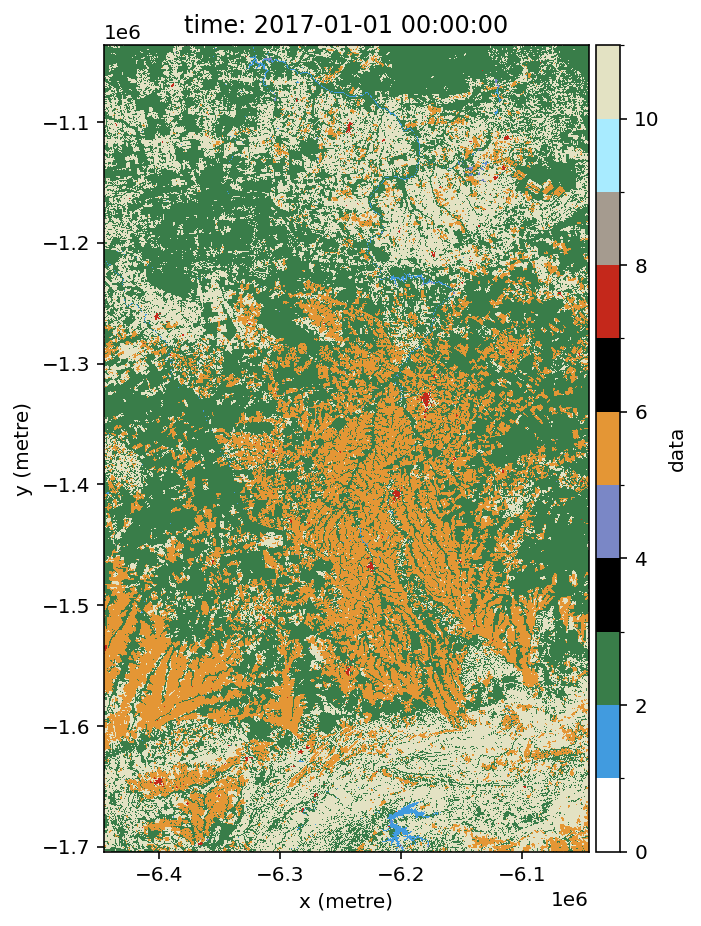

In [18]:
# Use holoviews to create interactive plot with a slider to see changes overtime

# plotting helpers
levels = [i for i in range(lc_cmap.N)]
bnorm = mplc.BoundaryNorm(levels, ncolors=len(levels))

# https://holoviews.org/user_guide/Gridded_Datasets.html?highlight=dask#working-with-xarray-data-types
hv.extension('matplotlib')
hv_ds = hv.Dataset(lcxr)[:, :, :]

lcmaps = hv_ds.to(hv.Image, kdims=["x", "y"], dynamic=True).options(cmap=lc_cmap, norm=bnorm, fig_inches=(5,8), colorbar=True)
lcmaps

#### 6. Analysing Aggregate Change

In this section we’re going to examine land cover change across the study area. Our aim is to produce a bar plot that shows increases or decreases in land area for each land cover class between two points in time.

We can quickly identify the unique values in our land cover maps and how many times they are observed (i.e. how many pixels fall in each land cover class). We can use numpy’s .unique function to count the occurrence of each value, then output as a Pandas DataFrame.

In [19]:
#list to hold pixel counts, class ID:name dict as list to append to 
counts_ls = [values_to_classes]

#loop over items
for i, j in enumerate(signed_items):
    lcmap = lcxr.isel(time=i).to_array("band")            #get pixels for this year as an array
    unique, counts = np.unique(lcmap.values, return_counts=True) #get the unique values and corresponding counts 
    lcmap_counts = dict(zip(unique, counts))               #combine them into a dict for easier viewing
    counts_ls.append(lcmap_counts)    

counts_df = pd.DataFrame(counts_ls).T     #create df from list and transpose

#create list of data years as string
counts_yr = list(lcxr["time"].values.astype('datetime64[Y]').astype('str'))  

counts_yr.insert(0, "Land Cover")        #insert 'LC'
counts_df.columns = counts_yr            #then use as df header
counts_df                                #print

,Land Cover,2017,2018,2019,2020,2021,2022
0,No Data,NaN,NaN,NaN,NaN,NaN,NaN
1,Water,11414,12011,13848,13921,14273,14892
2,Trees,1485124,1506206,1489276,1474662,1477771,1472174
4,Flooded vegetation,1157,1532,2369,1435,1358,1437
5,Crops,683380,678552,685153,737470,793002,833377
7,Built area,5583,5882,5929,6243,6546,6973
8,Bare ground,4859,2589,6022,6758,5217,4654
9,Snow/ice,NaN,NaN,NaN,NaN,NaN,NaN
10,Clouds,NaN,NaN,NaN,NaN,NaN,NaN
11,Rangeland,785533,770278,774453,736561,678883,643543


In [20]:
# Convert the pixel counts to area (sq km)

def cell_to_sqkm(x):
    return x * ((datares*datares) / 1000000)

sqkm_df = counts_df.copy(deep=False)
sqkm_df.loc[:,'2017':] = sqkm_df.loc[:,'2017':].apply(cell_to_sqkm)

sqkm_df

,Land Cover,2017,2018,2019,2020,2021,2022
0,No Data,NaN,NaN,NaN,NaN,NaN,NaN
1,Water,1027.26,1080.99,1246.32,1252.89,1284.57,1340.28
2,Trees,133661.16,135558.54,134034.84,132719.58,132999.39,132495.66
4,Flooded vegetation,104.13,137.88,213.21,129.15,122.22,129.33
5,Crops,61504.2,61069.68,61663.77,66372.3,71370.18,75003.93
7,Built area,502.47,529.38,533.61,561.87,589.14,627.57
8,Bare ground,437.31,233.01,541.98,608.22,469.53,418.86
9,Snow/ice,NaN,NaN,NaN,NaN,NaN,NaN
10,Clouds,NaN,NaN,NaN,NaN,NaN,NaN
11,Rangeland,70697.97,69325.02,69700.77,66290.49,61099.47,57918.87


We can see that some land cover classes are not present in any year (indicated by NaN). We’ll drop these and also reshape the data from ‘wide’ to ‘long’ for plotting.

In [21]:
sqkm_df = sqkm_df.dropna()    #drop No Data rows

#make data long
sqkm_df_long = pd.melt(sqkm_df, id_vars=['Land Cover'])
sqkm_df_long.rename(columns={'variable':'Year','value':'Area (sq km)'}, inplace = True)

From the Pandas DataFrame we can create both static and interactive bar plots. Here’s the static version with matplotlib.

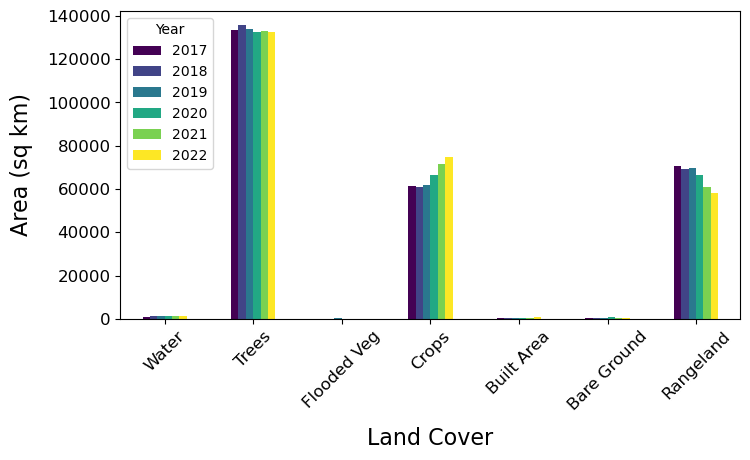

In [22]:
%matplotlib inline
fig, ax1 = plt.subplots(1, figsize=(8,4))

#drop NAN rows from data when plotting
sqkm_df[sqkm_df['2017'] > 0].set_index('Land Cover').plot(kind='bar', ax=ax1, cmap='viridis')

x_ticks_labels = ['Water','Trees','Flooded Veg','Crops', 'Built Area', 'Bare Ground', 'Rangeland']
ax1.set_xticklabels(x_ticks_labels, rotation=45)

plt.tick_params(labelsize=12)  
plt.xlabel('Land Cover', labelpad=10, fontsize=16)
plt.ylabel("Area (sq km)",labelpad=10, fontsize=16)     
plt.legend(title="Year")
plt.show()

We could also do an interactive plot with hvplot for Pandas data (see the cell below).

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
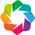

:Bars   [Land Cover,Year]   (Area (sq km))

In [23]:
hv.extension('bokeh')
color_lst = [mplc.to_hex(colormap[1]),mplc.to_hex(colormap[2]),mplc.to_hex(colormap[4]),
             mplc.to_hex(colormap[5]),mplc.to_hex(colormap[7]),mplc.to_hex(colormap[8]),mplc.to_hex(colormap[11])]
lc_year_bar = sqkm_df_long.hvplot.bar(y='Area (sq km)', x='Land Cover', by='Year', rot=90).options(
    color='Land Cover', cmap=color_lst, show_legend=False)
lc_year_bar

From the plots above we can see that through time the Trees and Rangeland classes have decreased in area, while Crops has increased. We could also show this by calculating and plotting the change between first and final time snapshot.

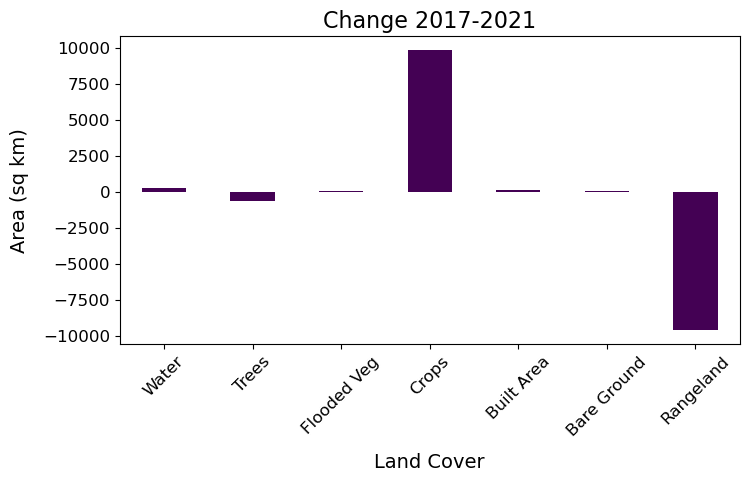

In [160]:
%matplotlib inline
#calculate
sqkm_df['Diffc-1721'] = sqkm_df['2021'] - sqkm_df['2017']

#plot
fig, ax1 = plt.subplots(1, figsize=(8,4))
sqkm_df['Diffc-1721'].plot(kind='bar', ax=ax1, cmap='viridis')
x_ticks_labels = ['Water','Trees','Flooded Veg','Crops', 'Built Area', 'Bare Ground', 'Rangeland']
ax1.set_xticklabels(x_ticks_labels, rotation=45)
plt.title("Change 2017-2021", size=16)
plt.tick_params(labelsize=12)  
plt.xlabel('Land Cover', labelpad=10, fontsize=14)
plt.ylabel("Area (sq km)",labelpad=10, fontsize=14)     
plt.show()

#### 7. Analysing Pixel by Pixel Change

In the last section we saw overall change in the land covers (e.g. decrease in Trees and Rangeland, increase in Crops). But which classes were changing to which other classes?

To understand the transitions between each class we need to analyse change for each pixel individually. We’ll enumerate individual pixels’ transitions for the first and last time snapshots using the a confusion matrix (using a function from sklearn and then visualise using a Sankey diagram (using holoviews).

First, the confusion matrix.

In [161]:
#connvert xarray DataArrays to numpy arrays
lc2017 = lcxr.sel(time='2017').isel(time=0).to_array("band").values.flatten()
lc2021 = lcxr.sel(time='2021').isel(time=0).to_array("band").values.flatten()

#create the confustion matrix using sklearn
conf = metrics.confusion_matrix(lc2017, lc2021)

#output as Pandas DF (drop no data land covers)
conf_pd = pd.DataFrame(conf,
                       index=sqkm_df[sqkm_df['2017'] != None]['Land Cover'],
                       columns=sqkm_df['Land Cover'])
conf_pd

Land Cover,Water,Trees,Flooded vegetation,Crops,Built area,Bare ground,Rangeland
Land Cover,,,,,,,
Water,10185,473,66,74,10,5,601
Trees,2577,1410068,245,23500,180,504,48050
Flooded vegetation,214,100,678,7,0,15,143
Crops,167,9397,3,638037,476,1746,33554
Built area,5,60,1,125,5227,5,160
Bare ground,15,179,42,2221,15,1251,1136
Rangeland,1110,57494,323,129038,638,1691,595239


confusion matrix whose i-th row and j-th column entry indicates the number of samples with true label being i-th class and predicted label being j-th class. So for us, this means 2017 classes are the rows, with 2021 classes in columns (there are no predictions here - the 2021 observations are in place of any prediction). The number of cells that did not change are on the diagonal. 

This shows the most frequent transition was from Rangeland to Crops with 129,038 cells. Given that each cell is 9 hectares (300m x 300m) that means more than 1.1 million hectares (11,000 sq km) changed from pasture to cropland over the four years!

Now we can use the confusion matrix (after some manipulation) to create an interactive Sankey diagram using holoviews to visualise the transitions between each of the classes.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
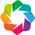

:Sankey   [From,To]   (Transition)

In [162]:
#create the nodes
lc_nodes = list(conf_pd.index) + list(conf_pd.index)
nodes = hv.Dataset(enumerate(lc_nodes), 'index', 'label')

#create the edges (flows between nodes)
#list of source lcs
sourcelc = []
for i in range(0, 7):
    sourcelc += [i] * 7
#list of target lcs
targetlc = list(range(7,14))
targetlc *= 7    
                 
#list of transition counts    
conf_list = conf.flatten().tolist()  
#convert to area and round (for hover display)
conf_sqkm_list = list(map(cell_to_sqkm, conf_list))
conf_sqkm_list = [round(item) for item in conf_sqkm_list]

#combine lists for sankey
edges_sqkm = list(zip(sourcelc, targetlc, conf_sqkm_list))

#from holoviews import opts, dim
hv.extension('bokeh')
value_dim = hv.Dimension('Transition', unit='sq km')

#create the sankey from the edges and nodes
transitions = hv.Sankey((edges_sqkm, nodes), ['From', 'To'], vdims=value_dim)

transitions = transitions.opts(
    opts.Sankey(labels='label', label_position='right', show_values=False, width=900, height=300, cmap=color_lst,
                edge_color=dim('From').str(), node_color=dim('label').str()))
transitions

Using the data objects we created to make the Sankey diagram, we can also view the most frequent transitions in a table:

In [163]:
edges = list(zip(sourcelc, targetlc, conf_list))                   #edges as counts
trans_df = pd.DataFrame(edges, columns =['From', 'To', 'Count'])   #convert edges list of tuples to pandas df

nodes_dict = dict(zip(list(nodes['index']),list(nodes['label'])))  #create dictionary for next replace calls
trans_df['From'].replace(to_replace=nodes_dict, inplace=True)      #replace ids with labels
trans_df['To'].replace(to_replace=nodes_dict, inplace=True)        #replace ids with labels

trans_df = trans_df[trans_df['To'] != trans_df['From']]            #remove rows of 'no transition'
trans_df['Area (sqkm)'] = trans_df['Count'].apply(cell_to_sqkm)    #add area column
trans_df.sort_values('Count', ascending=False).head()              #output head, sorted

,From,To,Count,Area (sqkm)
45,Rangeland,Crops,129038,11613.42
43,Rangeland,Trees,57494,5174.46
13,Trees,Rangeland,48050,4324.50
27,Crops,Rangeland,33554,3019.86
10,Trees,Crops,23500,2115.00


Now we can see that although large numbers of cells changed from Rangeland to other land covers, there were also relatively large numbers of cells changing into Rangeland. Check you can see this in the Sankey diagram above.

#### 8. Analysing Zonal Change

Above we have analysed the data for our entire study area and on a pixel-by-pixel basis. But sometimes we want to work at a level between the entire study area and individuals, using zones that belong to some kind of vector geography. This is where raster zonal statistics come in:

Zonal Statistics uses groupings to calculate statistics for specified zones.

The statistics are summary statistics (e.g. mean, median, standard deviation) of all the pixels that fall in each zone. The zones might be watersheds, biomes or ecoregions (physically) or states, countries, counties or census districts (socio-economically).

Here, we’ll use municipality boundaries as zones. For Brazil these are freely available online in (zipped) shapefile format which we can read using GeoPandas (which inherits from Pandas).

In [165]:
#load shapefile for municipalities
zipfile = "https://geoftp.ibge.gov.br/organizacao_do_territorio/malhas_territoriais/malhas_municipais/municipio_2021/UFs/MT/MT_Municipios_2021.zip"
munis = gpd.read_file(zipfile)
munis.head()

,CD_MUN,NM_MUN,SIGLA,AREA_KM2,geometry
0,5100102,Acorizal,MT,850.763,"POLYGON ((-56.22987 -14.98368, -56.22538 -14.9..."
1,5100201,Água Boa,MT,7549.308,"POLYGON ((-53.09875 -13.63518, -52.93808 -13.6..."
2,5100250,Alta Floresta,MT,8955.410,"POLYGON ((-55.8674 -9.44394, -55.86829 -9.4455..."
3,5100300,Alto Araguaia,MT,5402.308,"POLYGON ((-53.2392 -16.80826, -53.23884 -16.80..."
4,5100359,Alto Boa Vista,MT,2248.414,"POLYGON ((-51.40209 -11.57606, -51.40099 -11.5..."


Before we can use these data with the raster data we need to do some manipulation, including:
- setting the dtype of the CD_MUN series appropriately
- setting the map projection to be consistent with that for the raster land cover data (we’ll also do this for the study area polygon we made above)

In [166]:
# Data manipulation

#munis.dtypes                                  #check dtypes
munis['CD_MUN'] = munis['CD_MUN'].astype(int)  #set appropriate for muni code
#munis.crs                                     #check projection
munis = munis.to_crs(SMepsg)                   #reproject to match our raster data
sa_gpd = sa_gpd.to_crs(SMepsg)         #also reproject sa_polygon

And now we can plot to check things are aligning nicely and to visualise our zones (municipalities).

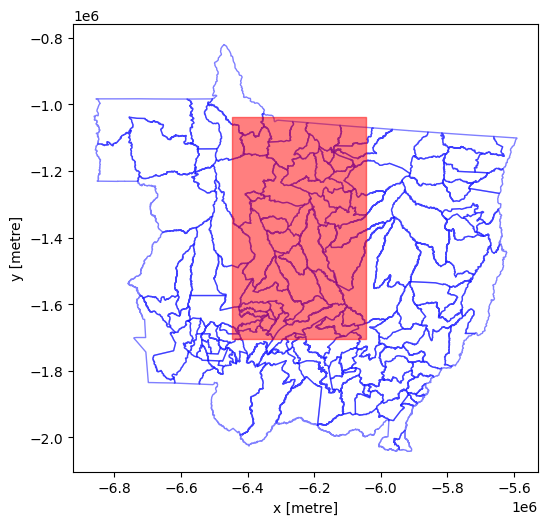

In [167]:
%matplotlib inline
fig, axes = plt.subplots(figsize=(6, 12))

munis.plot(
    ax=axes,
    edgecolor="blue",
    facecolor='None',
    categorical=True,
    aspect="equal",
    alpha=0.5
)

#add polygon to show our study area
sa_gpd.plot(edgecolor="red", facecolor="red", alpha=0.5, ax=axes)
axes.set_xlabel('x [metre]')
axes.set_ylabel('y [metre]')
plt.show()

In [168]:
# Do interactive plot with hvplot

import hvplot.pandas  
munis.hvplot(
    geo=True,crs=munis.crs.to_epsg(),alpha=0.25, tiles=True) * sa_gpd.hvplot(
    geo=True,crs=sa_gpd.crs.to_epsg(), alpha=0.25)

:Overlay
   .WMTS.I      :WMTS   [Longitude,Latitude]
   .Polygons.I  :Polygons   [Longitude,Latitude]
   .Polygons.II :Polygons   [Longitude,Latitude]

Let’s also make a static plot with matplotlib to visualise municipality boundaries over the raster land cover data.

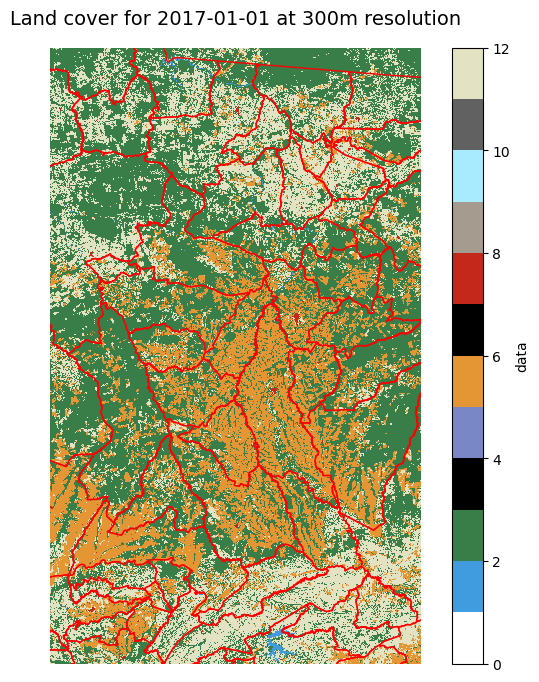

In [169]:
%matplotlib inline
fig,ax1=plt.subplots(figsize=(8,8))

#year 2017 is in the 0 position of lcxr['data']
lcxr['data'][0].plot(
    cmap=lc_cmap,
    vmin=vmin,
    vmax=vmax,
    ax=ax1
)

munis.plot(ax=ax1, facecolor='None', edgecolor='red', linewidth=1)

ax1.set_xlim(min(lcxr['data'][0].x), max(lcxr['data'][0].x)) 
ax1.set_ylim(min(lcxr['data'][0].y), max(lcxr['data'][0].y)) 
plt.axis('off')
plt.title("Land cover for {0} at {1}m resolution".format(ts, datares), size=14)
plt.show()

Before we do our zonal statistics, to make comparison fair we will consider only those municipalities whose boundaries are completely within the study area.

First, remove municipalities from the vector shapefile that are not completely within the study area.

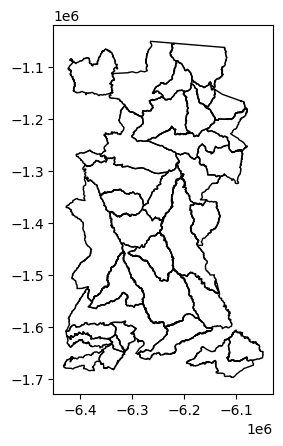

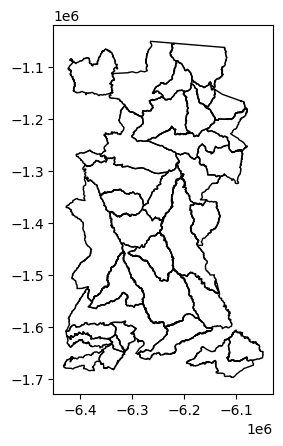

In [171]:
%matplotlib inline
pip_mask = munis.within(sa_gpd.loc[0, 'geometry'])  #spatial query: select only munis within study area
sa_munis = munis[pip_mask==True]                    #remove non-selected munis
sa_munis.plot(facecolor='None')                     #check by plotting
plt.show()

Next, create a raster from the new vector shapefile to mask cells from our land cover raster.

In [172]:
#collapse to list for rio.features.rasterize below
sa_munis_shapes = sa_munis[['geometry', 'CD_MUN']].values.tolist()

#get the spatial transform data needed for rio.features.rasterize below
lcxr_transform = lcxr['data'][0].rio.transform()   #this only works if rioxarray has been loaded - why? 

#create the mask raster (cells are CD_MUN for municipality polygons within study area, else -999)
sa_munis_r = rio.features.rasterize(sa_munis_shapes, fill=-999, 
                                    out_shape=lcxr['data'][0].shape, 
                                    transform=lcxr_transform) 

#create xarray DataArray from the new raster
sa_munis_xr = xr.DataArray(data=sa_munis_r,
                           name='Municipality code',
                           dims=["y", "x"],
                           coords={'y':('y',lcxr.y.data),
                                   'x':('x',lcxr.x.data)})

Let’s visualise the raster we’ve created from the vector shapefile of municipality boundaries.

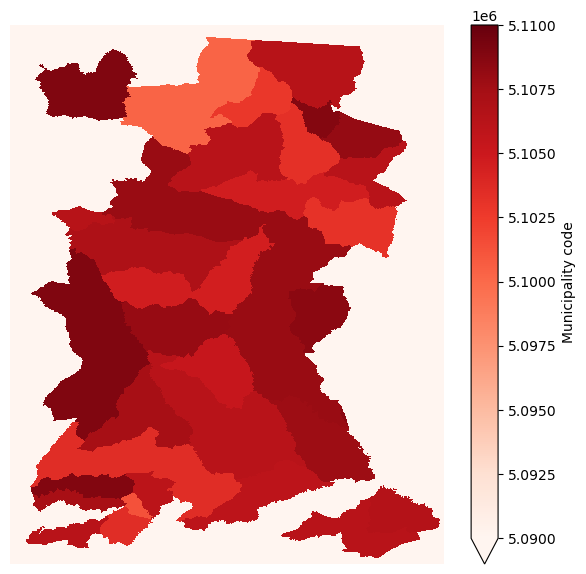

In [173]:
%matplotlib inline
fig,ax1=plt.subplots(figsize=(7,7))

sa_munis_xr.plot.imshow(
    cmap='Reds',
    vmin=5090000, vmax=5110000,
    ax=ax1
)

plt.axis('off')
plt.show()

And finally, mask the existing land cover xarray DataSet with this new xarray DataArray.

In [174]:
#mask original land cover xarray with new xarray
lcxr_mask = lcxr.where(sa_munis_xr >0)  #nodata was set to -999

Now let’s check the mask worked by plotting the new (masked) land cover data with the municipality polygons overlaid.

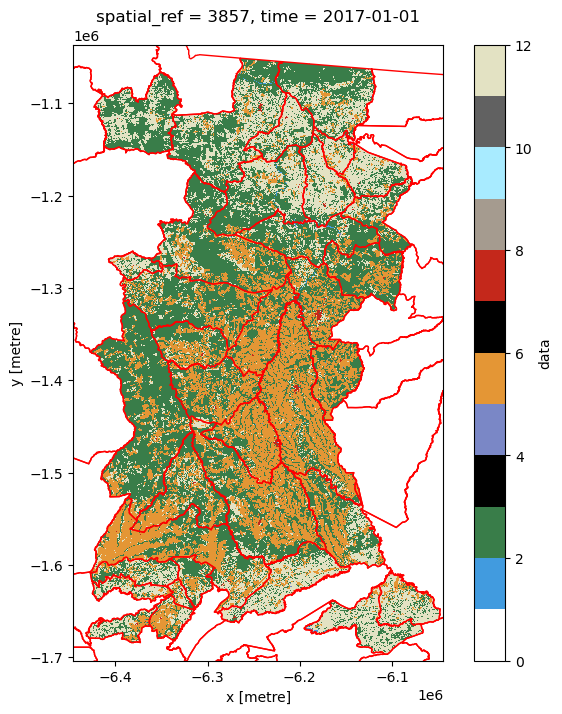

In [175]:
%matplotlib inline
fig,ax1=plt.subplots(figsize=(8,8))

p = lcxr_mask['data'][0].plot(
    cmap=lc_cmap,
    vmin=vmin,
    vmax=vmax,
    ax=ax1
)

munis.plot(ax=ax1, facecolor='None', edgecolor='red', linewidth=1)

ax1.set_xlim(min(lcxr['data'][0].x), max(lcxr['data'][0].x)) 
ax1.set_ylim(min(lcxr['data'][0].y), max(lcxr['data'][0].y)) 

plt.show()

From this plot you should be able to start thinking about the land cover composition of each municipality, and how they might differ. For example, which are the municipalities with relatively high (or low) crop cover compared to rangeland cover?

One last piece of data manipulation is needed as the zonal_stats function we will use from the rasterstats package expects a 2D array in a format that can be read by the rasterio package (e.g. a numpy array). Hence data are for a single year of our data set.

In [176]:
lcxr_transform = lcxr_mask['data'][0].rio.transform()     #get the spatial transform info 
lcxr_17 = np.array(lcxr_mask['data'][0].astype('int32'))  #convert data for 2017 to numpy array

#### 9. Zonal Stats

Now we’re ready to actually calculate the statistics from the land cover raster by municipality shapefile polygon. When specifying that our input raster is categorical (as is the case for our land cover data), the zonal_stats function returns a list of dictionaries, one for each municipality polgyon. In turn, each dictionary provides cell counts (values) for each (land cover) class (keys).

In [177]:
#from rasterstats import zonal_stats
lcxr_17z = zonal_stats(sa_munis, lcxr_17,
                           affine=lcxr_transform,
                           categorical=True)
lcxr_17z   

[{1: 467, 2: 55424, 4: 1, 5: 6225, 7: 296, 8: 79, 11: 40802},
 {2: 1298, 5: 1340, 7: 71, 11: 2264},
 {1: 390, 2: 9892, 5: 1536, 7: 49, 8: 54, 11: 16024},
 {1: 76, 2: 28919, 5: 12480, 7: 79, 8: 90, 11: 3094},
 {1: 262, 2: 10150, 4: 12, 5: 2246, 7: 118, 8: 32, 11: 23202},
 {1: 4, 2: 3926, 5: 7005, 7: 28, 8: 3, 11: 4240},
 {1: 15, 2: 33223, 4: 7, 5: 49192, 7: 188, 8: 63, 11: 15496},
 {1: 34, 2: 14085, 4: 20, 5: 24556, 7: 39, 8: 284, 11: 972},
 {1: 20, 2: 17018, 4: 5, 5: 13094, 7: 80, 8: 147, 11: 3680},
 {1: 820, 2: 34203, 4: 79, 5: 6941, 7: 35, 8: 63, 11: 10356},
 {1: 90, 2: 12272, 5: 28703, 7: 340, 8: 107, 11: 1758},
 {1: 17, 2: 11858, 4: 21, 5: 5391, 7: 105, 8: 23, 11: 29141},
 {1: 26, 2: 8113, 5: 3555, 7: 39, 8: 16, 11: 4179},
 {1: 6, 2: 15114, 4: 2, 5: 4206, 7: 30, 8: 76, 11: 8255},
 {1: 618, 2: 9902, 5: 1429, 7: 17, 11: 27368},
 {1: 650, 2: 35901, 4: 16, 5: 5528, 7: 49, 8: 88, 11: 26713},
 {1: 40, 2: 51898, 4: 16, 5: 50012, 7: 264, 8: 333, 11: 10289},
 {1: 19, 2: 5981, 5: 2891, 7: 60

In [178]:
# It’s easier to analyse this output if we store it as a Pandas DataFrame.

lcxr_17z_pd = pd.DataFrame(lcxr_17z)                        #convert list of dicts to DataFrame
lcxr_17z_pd.set_index(sa_munis['NM_MUN'],inplace=True)      #use municipality name as index
lcxr_17z_pd.rename(columns=values_to_classes,inplace=True)  #rename columns using dict created above
lcxr_17z_pd = lcxr_17z_pd.add_suffix('17')                  #remind ourselves these data are for a given year
lcxr_17z_pd.head()     

,Water17,Trees17,Flooded vegetation17,Crops17,Built area17,Bare ground17,Rangeland17
NM_MUN,,,,,,,
Alta Floresta,467.0,55424,1.0,6225,296,79.0,40802
Arenápolis,NaN,1298,NaN,1340,71,NaN,2264
Carlinda,390.0,9892,NaN,1536,49,54.0,16024
Cláudia,76.0,28919,NaN,12480,79,90.0,3094
Colíder,262.0,10150,12.0,2246,118,32.0,23202


We could examine these total counts, but in many ways it is more useful to consider the proportion of a muncipality that is covered by each land cover.

In [179]:
lcxr_17z_pd['sum17']=lcxr_17z_pd.sum(axis=1)                  #add column for total cells in the muni

lcxr_17prop_pd = pd.DataFrame(index = lcxr_17z_pd.index)      #create a new DataFrame to hold the proportions

#calculate proportion for each land cover
for column in lcxr_17z_pd.loc[:,'Water17':'Rangeland17']:
    lcxr_17prop_pd['{}-prop'.format(column)] = lcxr_17z_pd[column] / lcxr_17z_pd['sum17']  
    
lcxr_17prop_pd.head()

,Water17-prop,Trees17-prop,Flooded vegetation17-prop,Crops17-prop,Built area17-prop,Bare ground17-prop,Rangeland17-prop
NM_MUN,,,,,,,
Alta Floresta,0.004521,0.536566,0.000010,0.060265,0.002866,0.000765,0.395008
Arenápolis,NaN,0.261009,NaN,0.269455,0.014277,NaN,0.455258
Carlinda,0.013956,0.353981,NaN,0.054965,0.001753,0.001932,0.573412
Cláudia,0.001699,0.646408,NaN,0.278957,0.001766,0.002012,0.069158
Colíder,0.007273,0.281772,0.000333,0.062351,0.003276,0.000888,0.644106


We could create a-spatial plots (e.g. bar plots) directly from this DataFrame. To create spatial plots (maps) we need to attach the spatial information for each municipality to create a GeoPandas GeoDataFrame:

In [180]:
lcxr_17prop_gpd = pd.merge(sa_munis, lcxr_17prop_pd, how='left', left_on = 'NM_MUN', right_index=True)
lcxr_17prop_gpd.head()

,CD_MUN,NM_MUN,SIGLA,AREA_KM2,geometry,Water17-prop,Trees17-prop,Flooded vegetation17-prop,Crops17-prop,Built area17-prop,Bare ground17-prop,Rangeland17-prop
2,5100250,Alta Floresta,MT,8955.410,"POLYGON ((-6219130.124 -1056088.035, -6219229....",0.004521,0.536566,0.000010,0.060265,0.002866,0.000765,0.395008
12,5101308,Arenápolis,MT,417.337,"POLYGON ((-6330913.103 -1615920.187, -6330922....",NaN,0.261009,NaN,0.269455,0.014277,NaN,0.455258
26,5102793,Carlinda,MT,2421.788,"POLYGON ((-6212162.92 -1088961.922, -6211814.2...",0.013956,0.353981,NaN,0.054965,0.001753,0.001932,0.573412
29,5103056,Cláudia,MT,3843.561,"POLYGON ((-6153965.646 -1263744.447, -6153909....",0.001699,0.646408,NaN,0.278957,0.001766,0.002012,0.069158
31,5103205,Colíder,MT,3112.091,"POLYGON ((-6175226.198 -1146318.365, -6175285....",0.007273,0.281772,0.000333,0.062351,0.003276,0.000888,0.644106


And now we can do a static plot to visualise the proportion of two land covers across the municipalities.

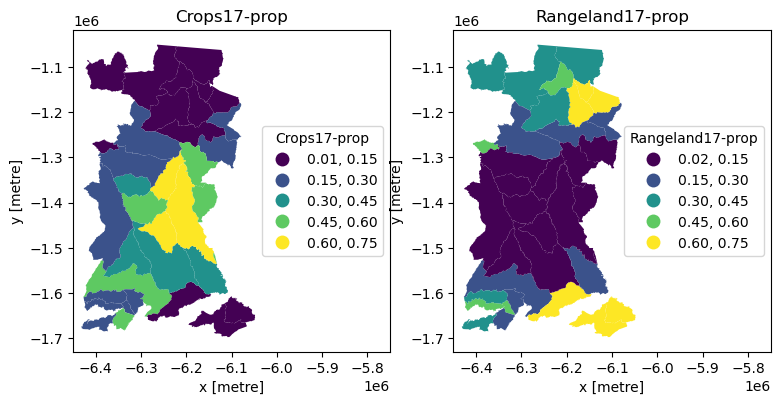

In [181]:
%matplotlib inline
cols = ['Crops17-prop','Rangeland17-prop']     #columns to plot
cbins = [0.15,0.3,0.45,0.6,0.75]               #classification bins for plotting

fig, ax = plt.subplots(1, 2, figsize=(9, 30))

for ix, col in enumerate(cols):
    lcxr_17prop_gpd.plot(
        column=col, cmap='viridis',
        scheme='UserDefined', 
        classification_kwds={'bins': cbins},  
        linewidth=0., 
        legend=True, legend_kwds={"title":col,"loc": 5},
        ax=ax[ix]
    )
    
    ax[ix].title.set_text(cols[ix])
    ax[ix].set_xlim(-6450000,-5750000)   #axis limits to fit legend
    ax[ix].set_xlabel('x [metre]')
    ax[ix].set_ylabel('y [metre]')

plt.show()

An interactive plot enables linked pan/zoom of the two variables (although without consistent classification of polygons).

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
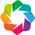

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (Crops17-prop)
   .Polygons.II :Polygons   [Longitude,Latitude]   (Rangeland17-prop)

In [182]:
cols = ['Crops17-prop','Rangeland17-prop']     #columns to plot

#import hvplot.pandas  # noqa
hv.extension('bokeh')
lcxr_17prop_interactive = lcxr_17prop_gpd.hvplot(
    c=cols[0],geo=True, crs=lcxr_17prop_gpd.crs.to_epsg(),cmap='viridis', title=cols[0]) + lcxr_17prop_gpd.hvplot(
    c=cols[1],geo=True, crs=lcxr_17prop_gpd.crs.to_epsg(),cmap='viridis', title=cols[1])

lcxr_17prop_interactive

From these plots we should be able to see what we might have expected from the raster data: municipalities in the north and south of the study area are dominated by rangeland, while those in the centre are dominated more by cropland. We might then think about what social, economic, political or other characteristics of the municipalities have led to this situation.

To examine change through time, we need to calculate the zonal stats for a second year, then calculate proportional change between the two time points. First the zonal stats.

In [183]:
lcxr_21 = np.array(lcxr_mask['data'][4].astype('int32'))  #convert data for 2021 to numpy array

lcxr_21z = zonal_stats(sa_munis, lcxr_21,
                           affine=lcxr_transform,
                           categorical=True)

lcxr_21z_pd = pd.DataFrame(lcxr_21z)                        #convert list of dicts to DataFrame
lcxr_21z_pd.set_index(sa_munis['NM_MUN'],inplace=True)      #use municipality name as index
lcxr_21z_pd.rename(columns=values_to_classes,inplace=True)  #rename columns using dict created above
lcxr_21z_pd = lcxr_21z_pd.add_suffix('21')                  #remind ourselves these data are for a given year

lcxr_21z_pd['sum21']=lcxr_21z_pd.sum(axis=1)                  #add column for total cells in the muni
lcxr_21z_pd.head() 

,Water21,Trees21,Flooded vegetation21,Crops21,Built area21,Bare ground21,Rangeland21,sum21
NM_MUN,,,,,,,,
Alta Floresta,467,54865,1.0,9039,337,194.0,38391,103294.0
Arenápolis,2,1312,NaN,2032,76,NaN,1551,4973.0
Carlinda,390,9823,NaN,2617,49,80.0,14986,27945.0
Cláudia,607,26625,1.0,14700,65,76.0,2664,44738.0
Colíder,376,10263,3.0,4660,140,24.0,20556,36022.0


Now calculate the proportional change between the two years.

In [184]:
lcxr_1721z_pd = pd.merge(lcxr_17z_pd, lcxr_21z_pd, how='left', left_index = True, right_index=True)

lcxr_1721prop_pd = pd.DataFrame(index = lcxr_1721z_pd.index)      #create a new DataFrame to hold the proportions

lcpresent = ['Water','Trees','Flooded vegetation','Crops', 'Built area', 'Bare ground', 'Rangeland']

#calculate proportional change for each land cover
for column in lcpresent:
    initial = lcxr_1721z_pd['{}17'.format(column)]
    final = lcxr_1721z_pd['{}21'.format(column)]
    lcxr_1721prop_pd['{}-propD'.format(column)] = (final - initial) / initial  
    
lcxr_1721prop_pd.describe()

,Water-propD,Trees-propD,Flooded vegetation-propD,Crops-propD,Built area-propD,Bare ground-propD,Rangeland-propD
count,34.000000,35.000000,15.000000,35.000000,35.000000,31.000000,35.000000
mean,0.546392,0.013755,0.626822,0.414401,0.132359,0.264670,-0.218614
std,1.542047,0.092306,1.125911,0.465972,0.112021,1.151980,0.124551
min,-0.315789,-0.133255,-0.750000,0.001309,-0.177215,-0.666667,-0.518625
25%,-0.035096,-0.012748,0.000000,0.078856,0.074984,-0.253253,-0.319861
50%,0.013201,-0.006975,0.363636,0.231721,0.142857,-0.120419,-0.187844
75%,0.266516,0.011556,1.104396,0.607837,0.202041,0.273100,-0.125082
max,6.986842,0.430131,3.571429,2.257058,0.358974,5.500000,-0.014088


From the summary statistics we can already begin to see differences in the trajectories of change. To map change spatially we finally merge with the spatial information.

In [185]:
lcxr_1721prop_gpd = pd.merge(sa_munis, lcxr_1721prop_pd, how='left', left_on = 'NM_MUN', right_index=True)

Given that proportional change can be positive or negative, we should use a diverging colour palette.

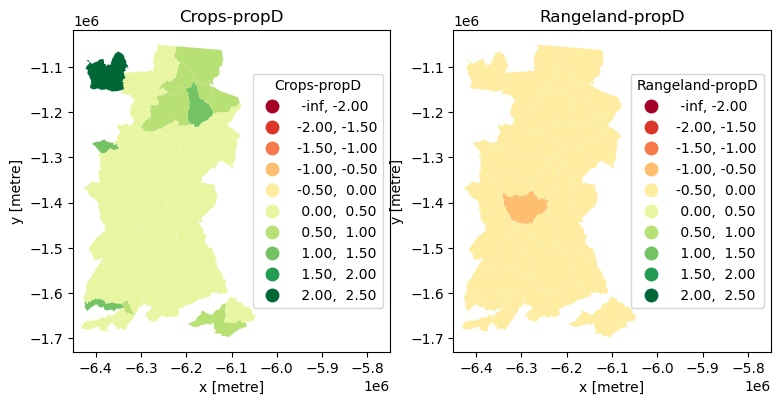

In [186]:
%matplotlib inline
cols = ['Crops-propD','Rangeland-propD']     #columns to plot
cbins = [-2,-1.5,-1,-0.5, 0, 0.5,1,1.5,2,2.5]               #classification bins for plotting

fig, ax = plt.subplots(1, 2, figsize=(9, 30))

for ix, col in enumerate(cols):
    lcxr_1721prop_gpd.plot(
        column=col, cmap='RdYlGn',   #colour palette
        scheme='UserDefined', 
        classification_kwds={'bins': cbins},  
        linewidth=0., 
        legend=True, legend_kwds={"title":col,"loc": 5},
        ax=ax[ix]
    )
    
    ax[ix].title.set_text(cols[ix])
    ax[ix].set_xlim(-6450000,-5750000)   #axis limits to fit legend
    ax[ix].set_xlabel('x [metre]')
    ax[ix].set_ylabel('y [metre]')

plt.show()

This allows us to see that all municipalities decreased their Rangeland cover and increased their Cropland cover between 2017 and 2021, and to locate municipalities with extremes of change (which we could then go and further investigate).

#### 10. Summary

This notebook introduce manipulation and exploratory analysis of classified land cover data. Specifically, it:
- used pystac-client to access information from the Microsoft’s Planetary Computer API and used that with odc-stac to read land cover raster data from an online repository.
- used matplotlib and holoviews to visualise the spatio-temporal land cover data statically and interactively.
- used from sklearn to create a matrix of pixel-by-pixel change and then holoviews to visualise that change using a Sankey diagram.
- used rasterstats to analyse zonal change with tabular data and visualisations.